In [ ]:
!pip install wandb onnx -Uq

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 16.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.7/15.7 MB 68.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 195.4/195.4 kB 25.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 258.5/258.5 kB 31.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 9.8 MB/s eta 0:00:00


In [ ]:
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
import torch.utils.data
import torchvision
import time
from PIL import Image
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split
import wandb
import torch.nn.functional as F
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix
from sklearn.manifold import TSNE
from mpl_toolkits.mplot3d import Axes3D
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
from collections import Counter
import torchvision.models as models
from torch.nn import CrossEntropyLoss
from torch.optim import Adam


In [ ]:
class_labels = {
    0: 'Road', 2: 'Sidewalk', 4: 'Person', 5: 'Rider', 6: 'Motorbike',
    7: 'Bicycle', 9: 'Car', 10: 'Truck', 11: 'Bus', 12: 'Train',
    14: 'Wall', 15: 'Fence', 18: 'Traffic Sign', 19: 'Traffic Light',
    20: 'Pole', 22: 'Building', 24: 'Vegetation', 25: 'Sky',
}

label_color_mapping = {
    0: (128, 64, 128),  # Road
    2: (244, 35, 232),  # Sidewalk
    4: (220, 20, 60),   # Person
    5: (255, 0, 0),     # Rider
    6: (0, 0, 230),     # Motorbike
    7: (119, 11, 32),   # Bicycle
    9: (0, 0, 142),     # Car
    10: (0, 0, 70),     # Truck
    11: (0, 60, 100),   # Bus
    12: (0, 80, 100),   # Train
    14: (102, 102, 156),# Wall
    15: (190, 153, 153),# Fence
    18: (220, 220, 0),  # Traffic Sign
    19: (250, 170, 30), # Traffic Light
    20: (153, 153, 153),# Pole
    22: (70, 70, 70),   # Building
    24: (107, 142, 35), # Vegetation
    25: (70, 130, 180), # Sky
    255: (0,0,0)
}

cityscape_id_to_color = {
    0: (128, 64, 128), # Road
    1: (244, 35, 232), # Sidewalk
    2: (70, 70, 70),   # Building
    3: (102, 102, 156),# Wall
    4: (190, 153, 153),# Fence
    5: (153, 153, 153),# Pole
    6: (250, 170, 30), # Traffic Light
    7: (220, 220, 0),  # Traffic Sign
    8: (107, 142, 35), # Vegetation
    9: (250, 170, 160),
    10: (70, 130, 180), # Sky
    11: (220, 20, 60),   # Person
    12:  (255, 0, 0),     # Rider
    13: (0, 0, 142),     # Car
    14:  (0, 0, 70),     # Truck
    15: (0, 60, 100),   # Bus
    16:(0, 80, 100),   # Train
    17: (0, 0, 230),     # Motorbike
    18: (119, 11, 32),   # Bicycle
    255: (0,0,0) #unlabeled
}

cityscapes_to_idd = {
    0: 0, # Road
    1: 2, # Sidewalk
    2: 22,   # Building
    3: 14,# Wall
    4: 15,# Fence
    5: 20,# Pole
    6: 19, # Traffic Light
    7: 18,  # Traffic Sign
    8: 24, # Vegetation
    9: 255,
    10: 25, # Sky
    11: 4,   # Person
    12:  5,     # Rider
    13: 9,     # Car
    14:  10,     # Truck
    15: 11,   # Bus
    16: 12,   # Train
    17: 6,     # Motorbike
    18: 7,   # Bicycle
    255: 255 #unlabeled
}

In [ ]:
class IDDDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = os.listdir(image_dir)
        self.masks = os.listdir(mask_dir)
        # self.images_data = [os.path.join(image_dir, img) for img in self.images]
        # self.masks_data = [os.path.join(mask_dir, img.replace('image', 'mask')) for img in self.images]
        self.images_data = [os.path.join(image_dir, img) for img in self.images]
        self.masks_data = [os.path.join(mask_dir, img.replace('image', 'mask')) for img in self.images]



    def __len__(self):
        return len(self.images_data)

    def __getitem__(self, index):
        image_path = self.images_data[index]
        mask_path = self.masks_data[index]

        image = Image.open(image_path)
        mask = Image.open(mask_path)
        if self.transform is not None:
            image = self.transform(image)
            mask = self.transform(mask)

        return image, mask




In [ ]:
root = 'drive/MyDrive/CV_HW1/IDD20K_II'
img_dir = 'drive/MyDrive/CV_HW1/IDD20K_II/image_archive'
mask_dir = 'drive/MyDrive/CV_HW1/IDD20K_II/mask_archive'

images = os.listdir(img_dir)
masks = os.listdir(mask_dir)
images_data = [os.path.join(img_dir, img) for img in images]
masks_data = [os.path.join(mask_dir, img.replace('image', 'mask')) for img in images]

In [ ]:
BATCH_SIZE = 64
resize_transformation = torchvision.transforms.Compose([
    #torchvision.transforms.Resize((512, 512)),
    torchvision.transforms.ToTensor()
])
idd_dataset = IDDDataset(img_dir, mask_dir, transform=resize_transformation)
data_loader = torch.utils.data.DataLoader(idd_dataset, batch_size = BATCH_SIZE, shuffle=True)

In [ ]:
print(len(masks_data))

6982


In [ ]:
pixel_counts = Counter()

for mask_path in masks_data:

    mask = Image.open(mask_path)
    mask_array = np.array(mask)

    unique, counts = np.unique(mask_array, return_counts=True)

    mask_counts = Counter(dict(zip(unique, counts)))

    filtered_mask_counts = Counter({class_labels[label]: mask_counts[label] for label in class_labels if label in mask_counts})

    pixel_counts.update(filtered_mask_counts)

print(pixel_counts)

In [ ]:
from torch import cuda
device = torch.device("cuda" if cuda.is_available() else "cpu")

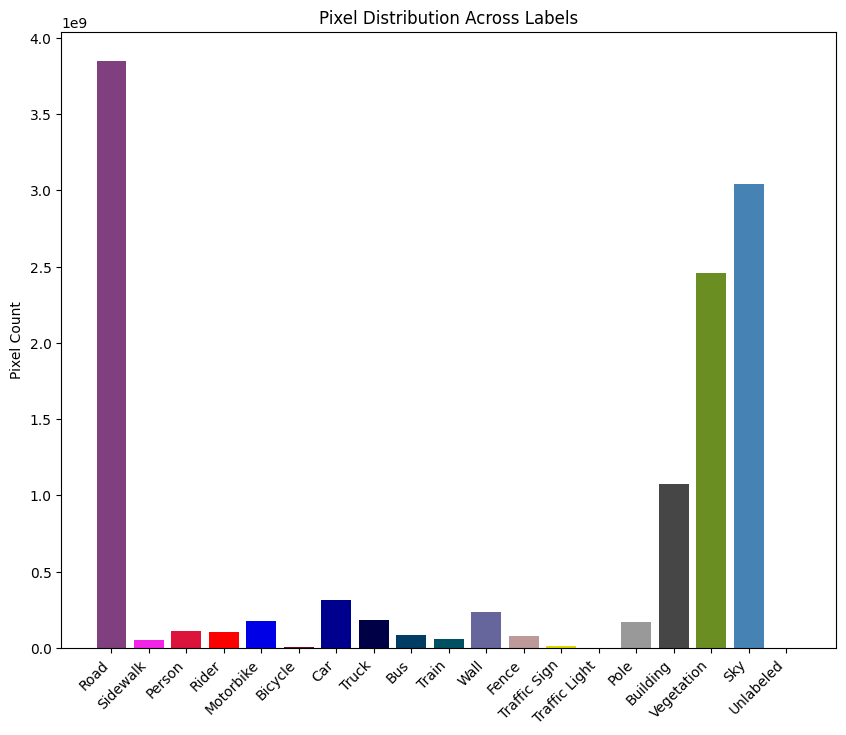

In [ ]:
labels = list(class_labels.values())
counts = [pixel_counts[label] for label in labels]
colors = [label_color_mapping[pixel_value] for pixel_value in class_labels.keys()]
colors = ['#%02x%02x%02x' % color for color in colors]


plt.figure(figsize=(10, 8))
plt.bar(labels, counts, color=colors)
plt.xticks(rotation=45, ha="right")
plt.ylabel('Pixel Count')
plt.title('Pixel Distribution Across Labels')
plt.show()

Visualizing class: Road


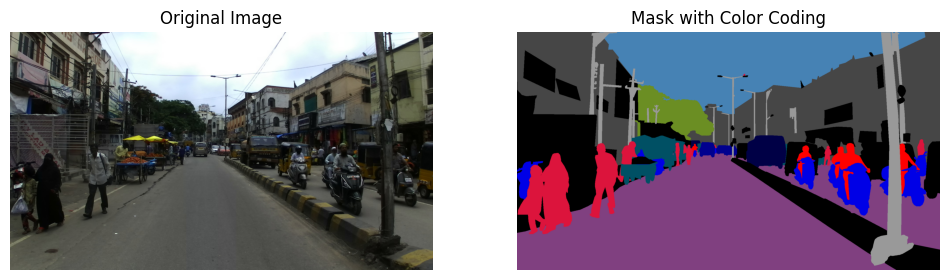

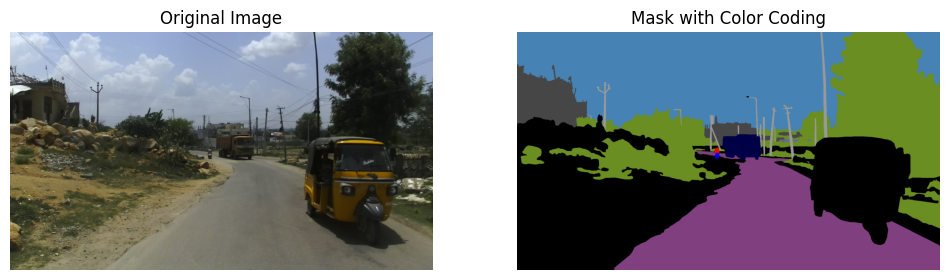

Visualizing class: Sidewalk


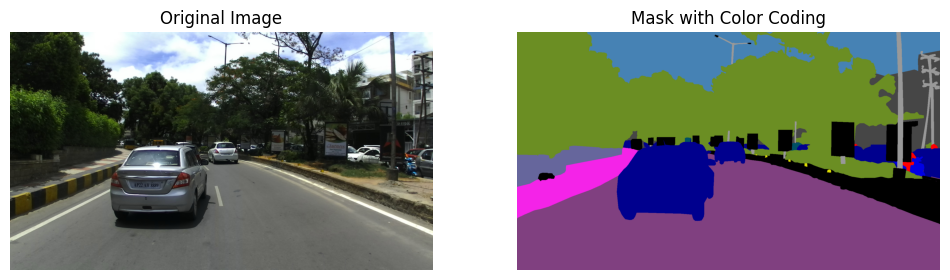

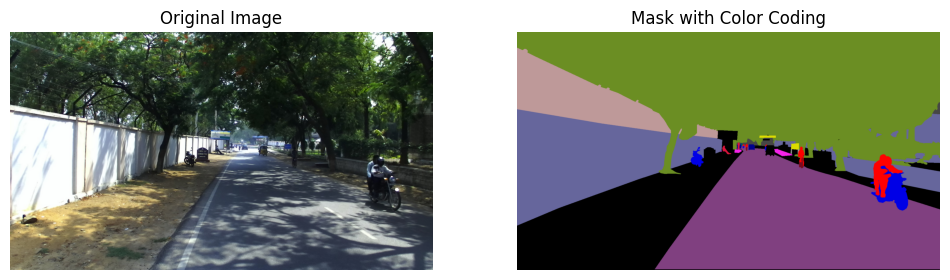

Visualizing class: Person


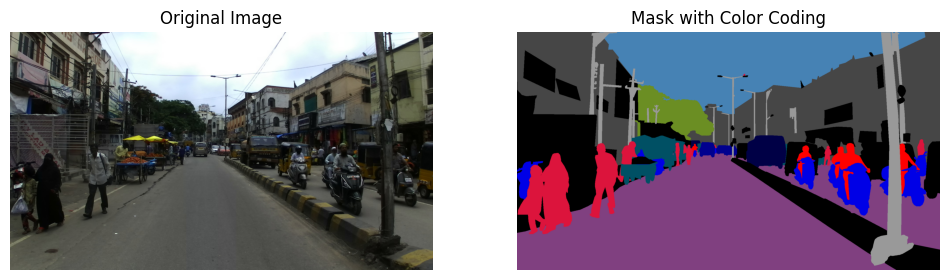

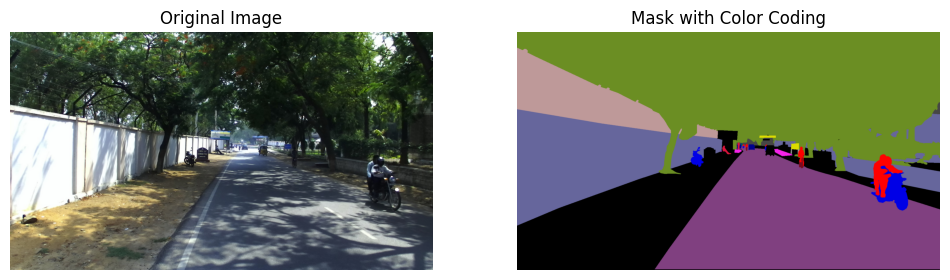

Visualizing class: Rider


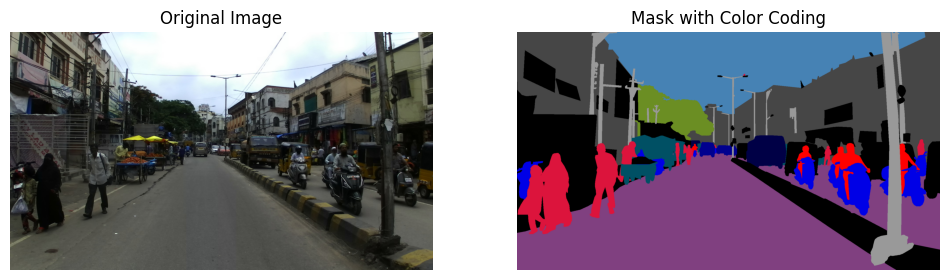

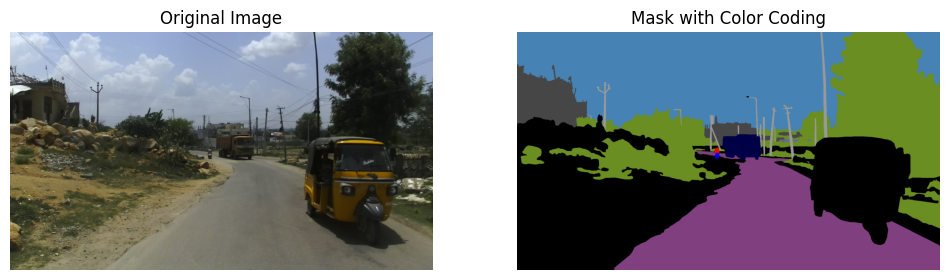

Visualizing class: Motorbike


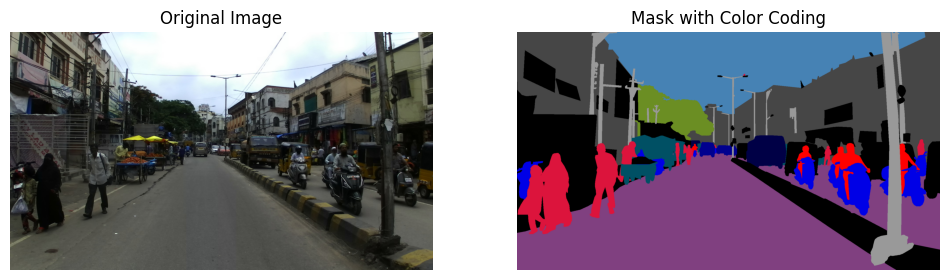

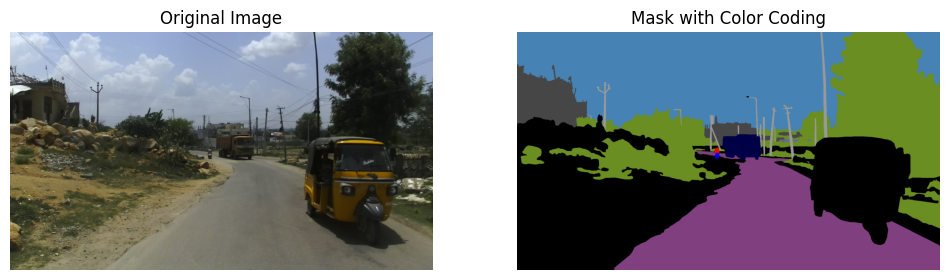

Visualizing class: Bicycle


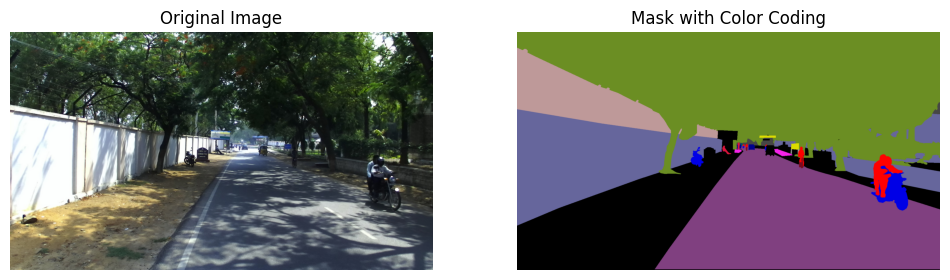

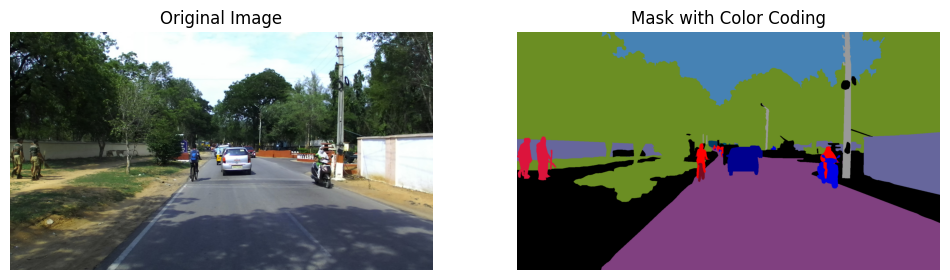

Visualizing class: Car


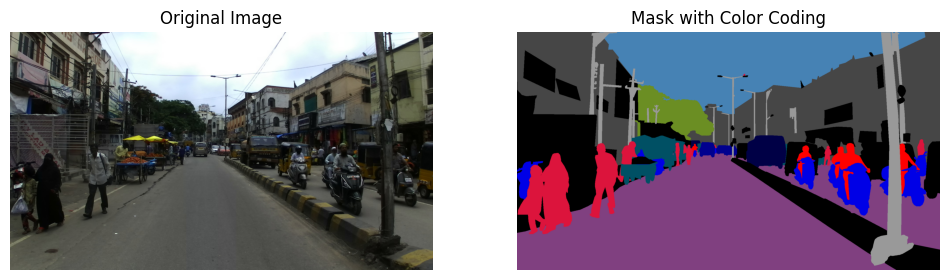

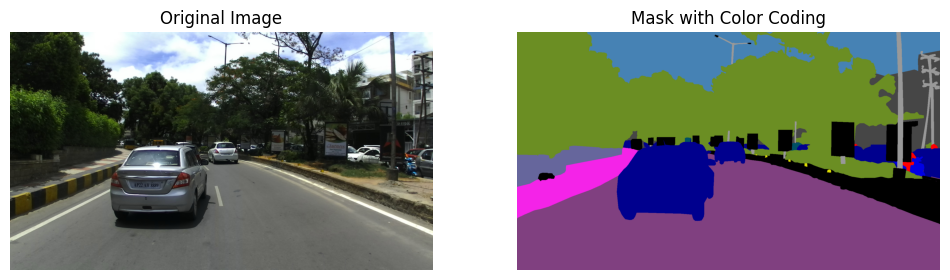

Visualizing class: Truck


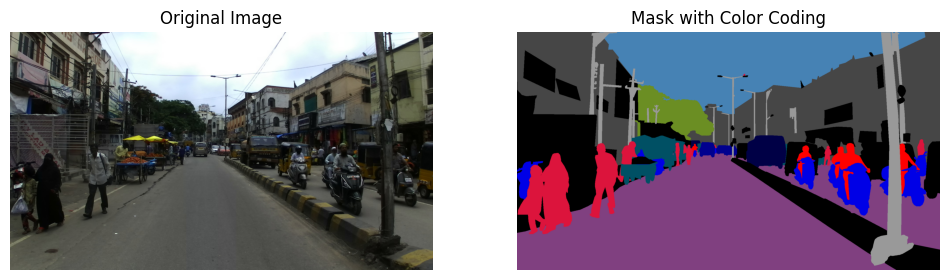

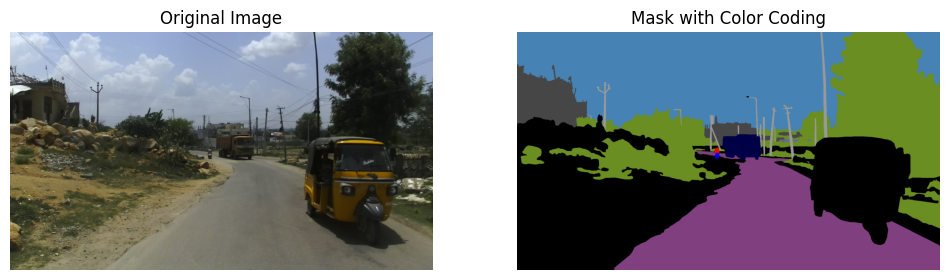

Visualizing class: Bus


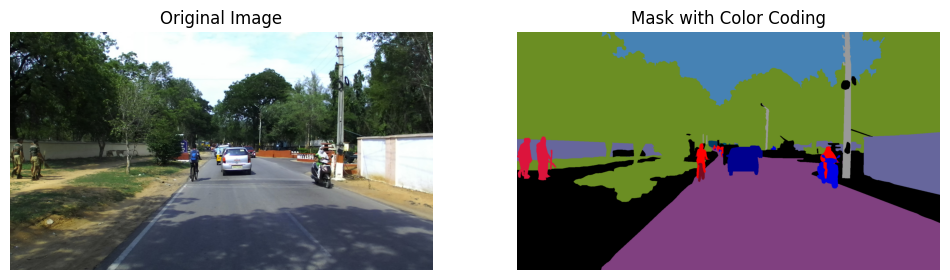

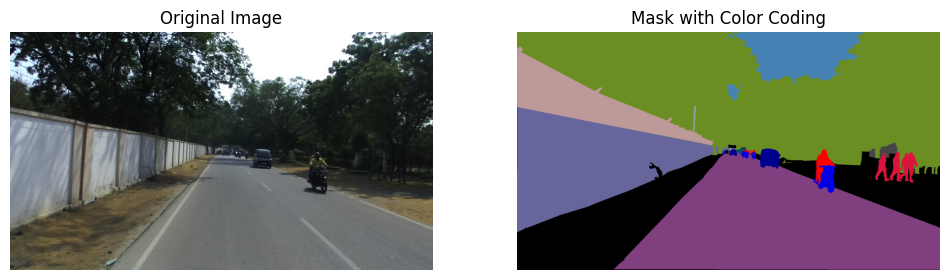

Visualizing class: Train


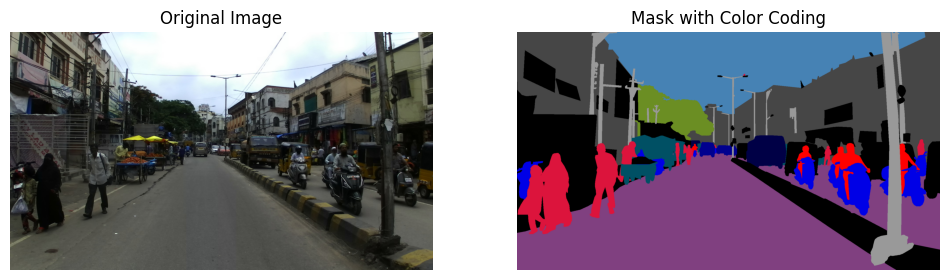

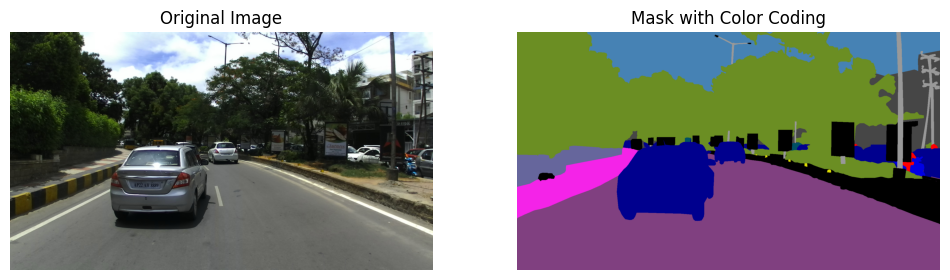

Visualizing class: Wall


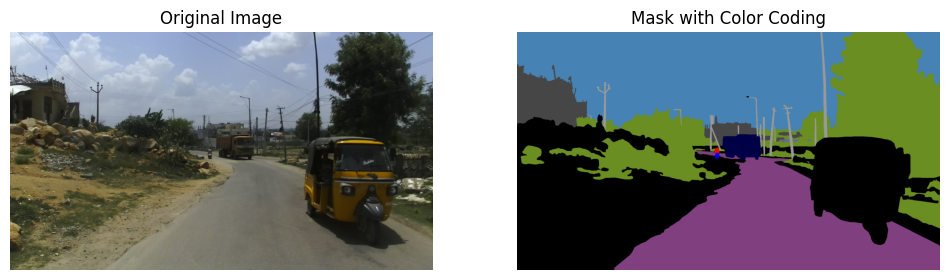

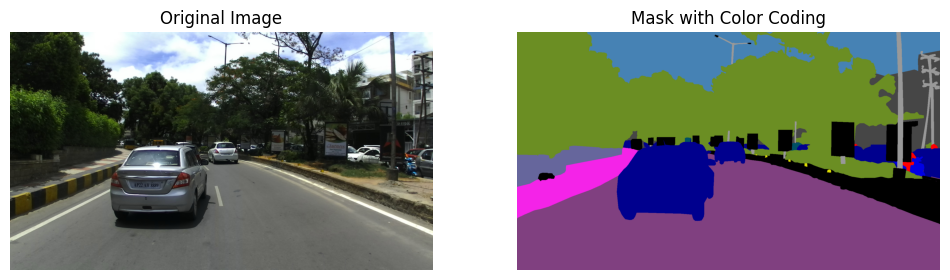

Visualizing class: Fence


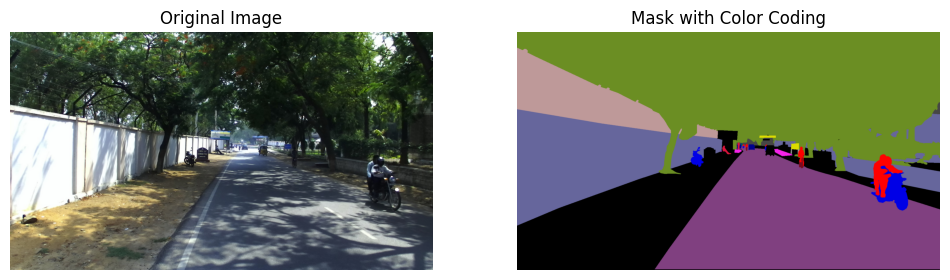

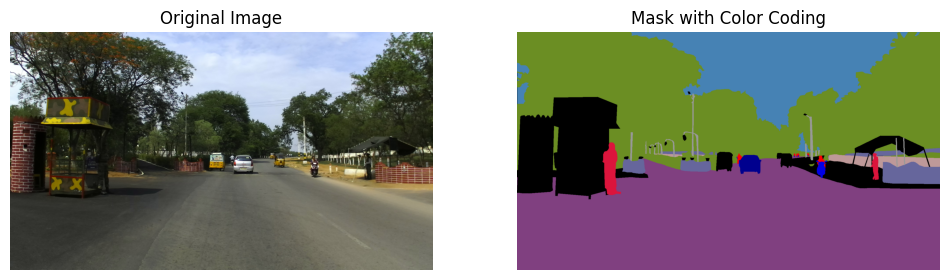

Visualizing class: Traffic Sign


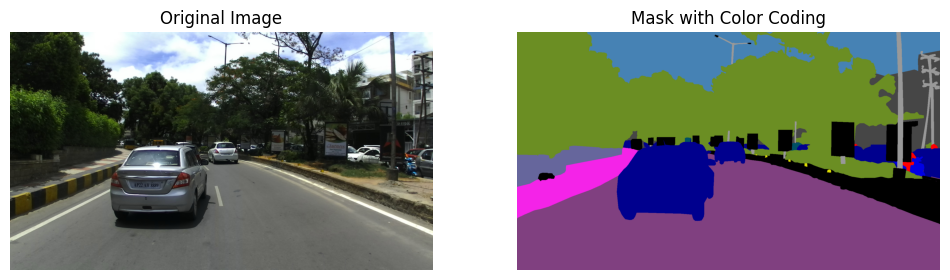

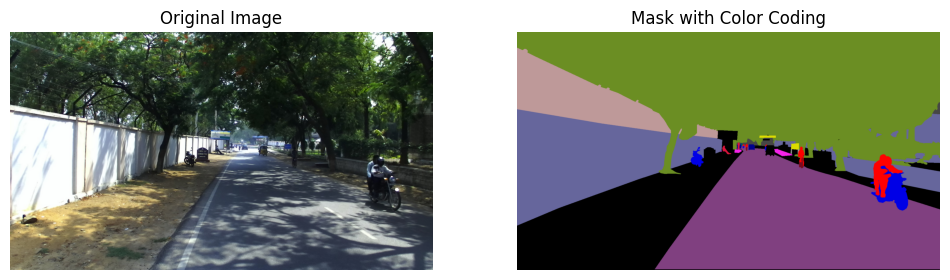

Visualizing class: Traffic Light


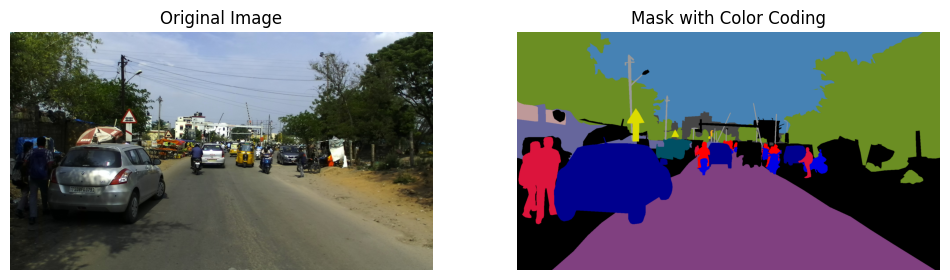

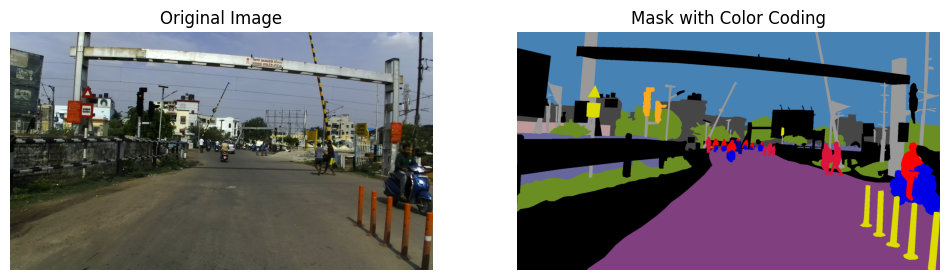

Visualizing class: Pole


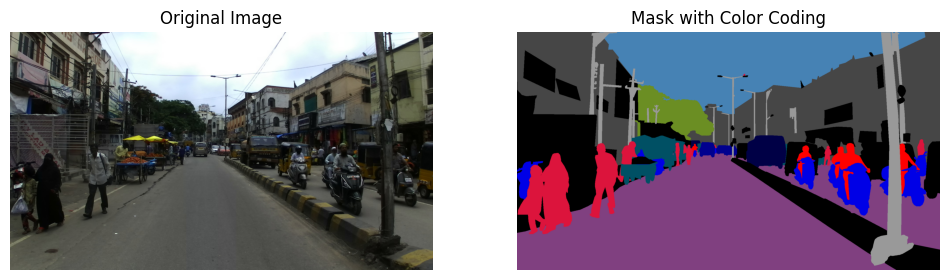

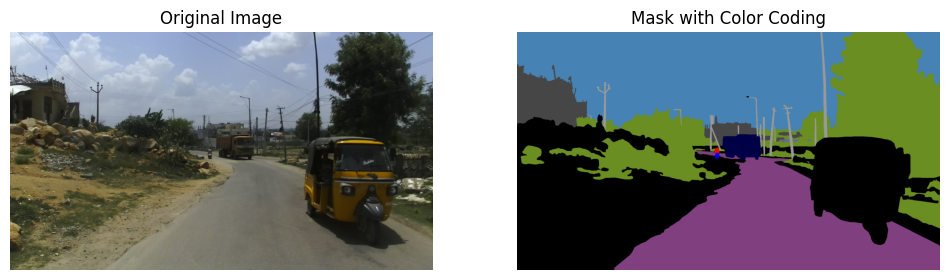

Visualizing class: Building


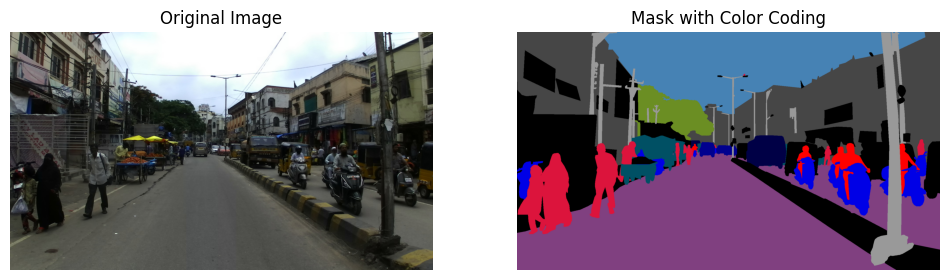

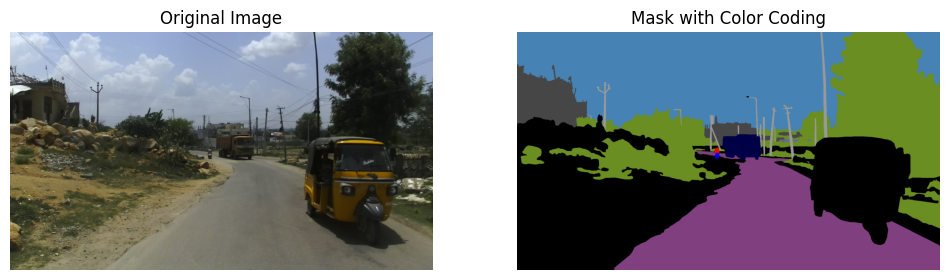

Visualizing class: Vegetation


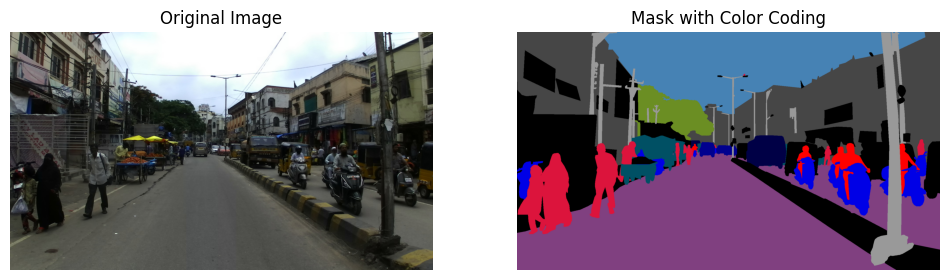

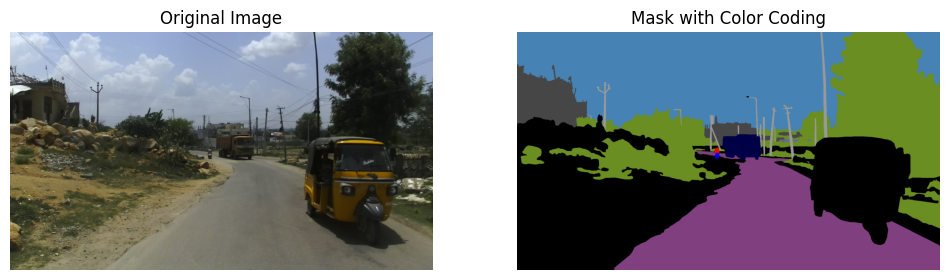

Visualizing class: Sky


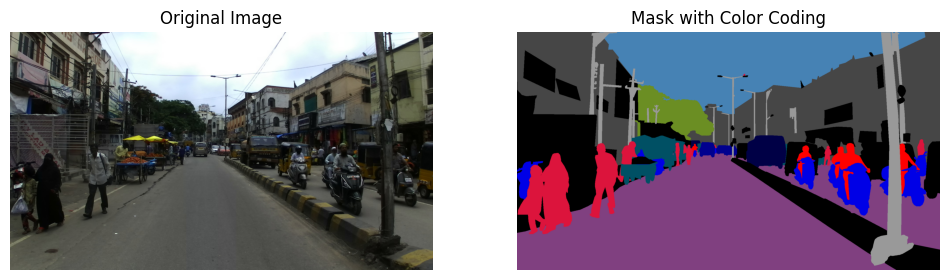

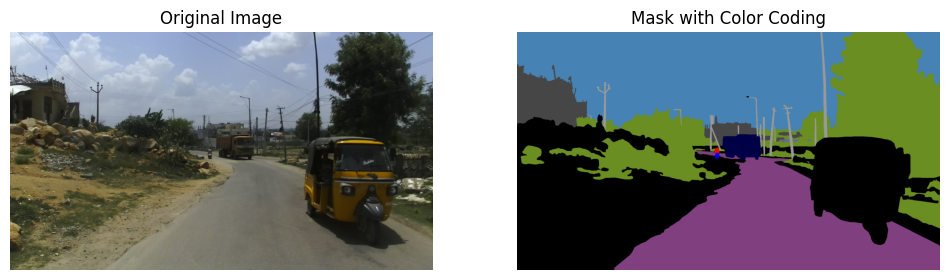

Visualizing class: Unlabeled
No images found for class Unlabeled


In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

def visualize_image_and_mask(image_path, mask_path, label_color_mapping):
    image = Image.open(image_path)
    mask = np.array(Image.open(mask_path))

    color_mask = np.zeros((mask.shape[0], mask.shape[1], 3), dtype=np.uint8)

    for label, color in label_color_mapping.items():
        mask_indices = mask == label
        color_mask[mask_indices] = color

    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    axs[0].imshow(image)
    axs[0].set_title('Original Image')
    axs[0].axis('off')

    axs[1].imshow(color_mask)
    axs[1].set_title('Mask with Color Coding')
    axs[1].axis('off')

    plt.show()

def find_images_for_class(mask_paths, class_id, num_images=2):
    selected_masks = []
    for path in mask_paths:
        mask = np.array(Image.open(path))
        if class_id in np.unique(mask):
            if class_id != 'Unlabeled':
                selected_masks.append(path)
                if len(selected_masks) == num_images:
                    break
    return selected_masks

def visualize_images_for_each_class(images_data, masks_data, class_labels, label_color_mapping):
    for class_id, class_name in class_labels.items():
        print(f"Visualizing class: {class_name}")

        selected_masks = find_images_for_class(masks_data, class_id)

        for mask_path in selected_masks:
            image_name = mask_path.split('/')[-1].replace('mask', 'image')
            image_path = os.path.join(img_dir, image_name)

            visualize_image_and_mask(image_path, mask_path, label_color_mapping)

        if not selected_masks:
            print(f"No images found for class {class_name}")

visualize_images_for_each_class(images_data, masks_data, class_labels, label_color_mapping)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!git clone https://github.com/VainF/DeepLabV3Plus-Pytorch.git

Cloning into 'DeepLabV3Plus-Pytorch'...
remote: Enumerating objects: 705, done.
remote: Counting objects: 100% (52/52), done.
remote: Compressing objects: 100% (38/38), done.
remote: Total 705 (delta 25), reused 30 (delta 14), pack-reused 653
Receiving objects: 100% (705/705), 8.26 MiB | 27.55 MiB/s, done.
Resolving deltas: 100% (380/380), done.


In [ ]:
import sys
sys.path.append('/content/DeepLabV3Plus-Pytorch')

from network.modeling import deeplabv3plus_resnet101

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

NUM_CLASSES = 19
model = deeplabv3plus_resnet101(NUM_CLASSES, output_stride=8)
model.load_state_dict(torch.load('/content/drive/MyDrive/best_deeplabv3plus_resnet101_cityscapes_os16.pth.tar', map_location=torch.device('cpu'))['model_state'])
model.to(device)
model.eval()


Using device: cuda


DeepLabV3(
  (backbone): IntermediateLayerGetter(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Se

In [ ]:

test_images = images_data[:int(len(images_data) * 0.3)]
test_masks = masks_data[:int(len(masks_data) * 0.3)]

In [ ]:
def map_predictions(preds, mapping):
    mapped_preds = np.vectorize(mapping.get)(preds)
    return mapped_preds

def compute_metrics(preds, gts, num_classes, class_labels):
    metrics = {
        'accuracy': {},
        'dice_coefficient': {},
        'iou': {},
        'precision': {},
        'recall': {}
    }

    mapped_preds = map_predictions(preds, cityscapes_to_idd)
    preds_flat = mapped_preds.flatten()
    gts_flat = gts.flatten()

    cm = confusion_matrix(gts_flat, preds_flat, labels=range(num_classes))
    #print(cm)

    i = 0
    for key, label in class_labels.items():
        TP = cm[i, i]
        FP = cm[:, i].sum() - TP
        FN = cm[i, :].sum() - TP
        TN = cm.sum() - (TP + FP + FN)

        accuracy = (TP + TN) / cm.sum()
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0
        iou = TP / (TP + FP + FN) if (TP + FP + FN) > 0 else 0
        dice = (2 * TP) / (2 * TP + FP + FN) if (2 * TP + FP + FN) > 0 else 0

        metrics['accuracy'][key] = accuracy
        metrics['dice_coefficient'][key] = dice
        metrics['iou'][key] = iou
        metrics['precision'][key] = precision
        metrics['recall'][key] = recall
        #print(metrics)

        i += 1

    return metrics

In [ ]:
test_images = test_images[:50]
test_masks = test_masks[:50]

In [ ]:
all_preds = []
all_gts = []


for img_path, mask_path in zip(test_images, test_masks):
    img = Image.open(img_path).resize((512, 512))
    input_tensor = transforms.ToTensor()(img).unsqueeze(0).to(device)
    outputs = model(input_tensor)
    preds = outputs.max(1)[1].detach().cpu().numpy()

    all_preds.append(preds[0])


    gt_img = Image.open(mask_path).resize((512, 512))
    gt = np.array(gt_img)
    all_gts.append(gt)

all_preds_array = np.array(all_preds)
all_gts_array = np.array(all_gts)



In [ ]:
 metrics = compute_metrics(all_preds_array, all_gts_array, len(class_labels), class_labels)

for metric, values in metrics.items():
    print(f"{metric}: {values}")


accuracy: {0: 0.8102181500770014, 2: 0.8700833267355911, 4: 0.9598400873292886, 5: 0.9733676986479494, 6: 0.978980223034155, 7: 0.9850608868901982, 9: 0.9757232369668548, 10: 0.983468272174738, 11: 0.9676768356847906, 12: 0.9539816798468341, 14: 0.9793577196591301, 15: 0.9932741500575167, 18: 0.989553836668993, 19: 0.9669278091620183, 20: 0.9811370432125341, 22: 0.9710968575156801, 24: 0.9973600266166598, 25: 0.9971387815527623}
dice_coefficient: {0: 0.8599099835536917, 2: 0.0, 4: 0.1771374256739133, 5: 0.0, 6: 0.42766302091783104, 7: 0.32107454832183213, 9: 0.31165140983102, 10: 0.061529953105728834, 11: 0.0, 12: 0.6433130553205688, 14: 0.33148794895952854, 15: 0.5017437308723399, 18: 0.006883196379812068, 19: 0.0, 20: 0.4462024290736667, 22: 0.2673353868200505, 24: 0.0, 25: 0.0}
iou: {0: 0.7542474463850273, 2: 0.0, 4: 0.09717541419127611, 5: 0.0, 6: 0.2719919626691434, 7: 0.19123812078785418, 9: 0.18458949274203387, 10: 0.031741503153122914, 11: 0.0, 12: 0.47417943973255816, 14: 0.19

In [ ]:
print("Unique predicted labels:", np.unique(all_preds_array))
print("Unique ground truth labels:", np.unique(all_gts_array))


In [ ]:
len(all_preds_array[0][0])


512

In [ ]:
len(all_gts_array)

2094

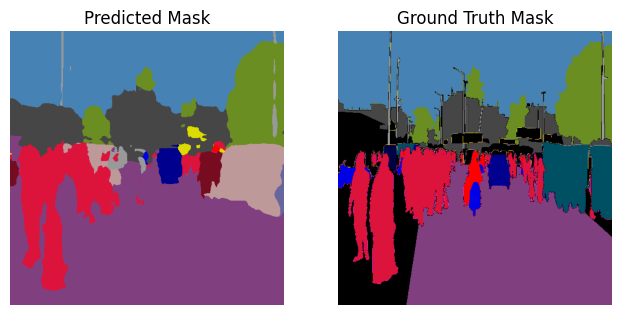

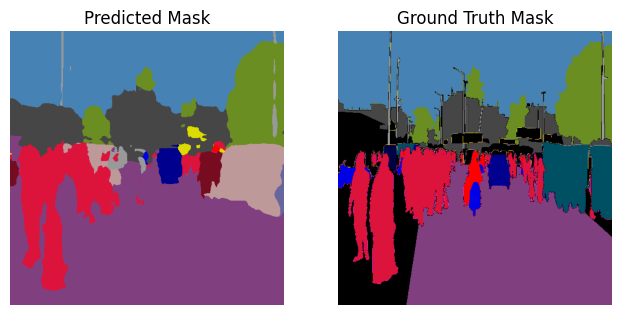

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image


def decode_segmentation_masks(mask, label_to_color_map):
    color_mask = np.zeros((mask.shape[0], mask.shape[1], 3), dtype=np.uint8)
    for label, color in label_to_color_map.items():
        color_mask[mask == label] = color
    return color_mask

for i in range(2):
    pred_mask = all_preds_array[i]
    gt_mask = all_gts_array[i]

    color_pred_mask = decode_segmentation_masks(pred_mask, cityscape_id_to_color)
    color_gt_mask = decode_segmentation_masks(gt_mask, label_color_mapping)

    color_pred_mask_image = Image.fromarray(color_pred_mask)
    color_gt_mask_image = Image.fromarray(color_gt_mask)

    plt.figure(figsize=(12, 4))
    plt.subplot(1, 3, 1)
    plt.imshow(color_pred_mask_image)
    plt.axis('off')
    plt.title('Predicted Mask')

    plt.subplot(1, 3, 2)
    plt.imshow(color_gt_mask_image)
    plt.axis('off')
    plt.title('Ground Truth Mask')

    plt.show()


Visualizing for class: 0 - Road


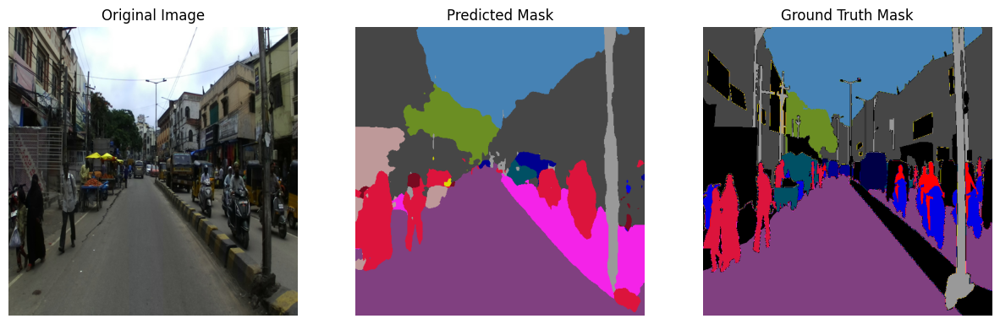

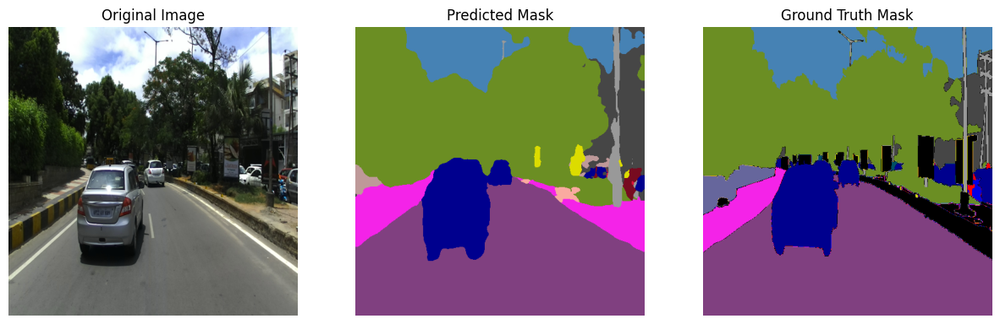

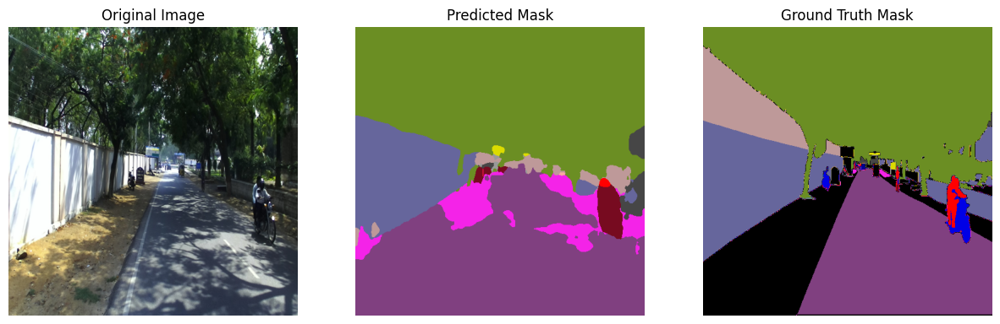

Visualizing for class: 1 - Unknown
Visualizing for class: 2 - Sidewalk


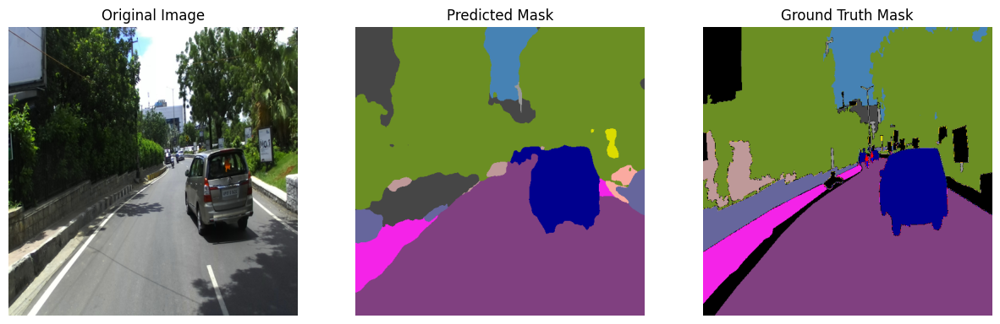

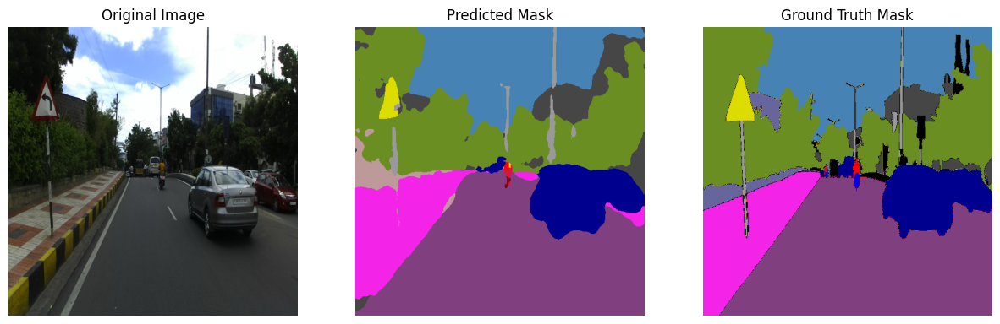

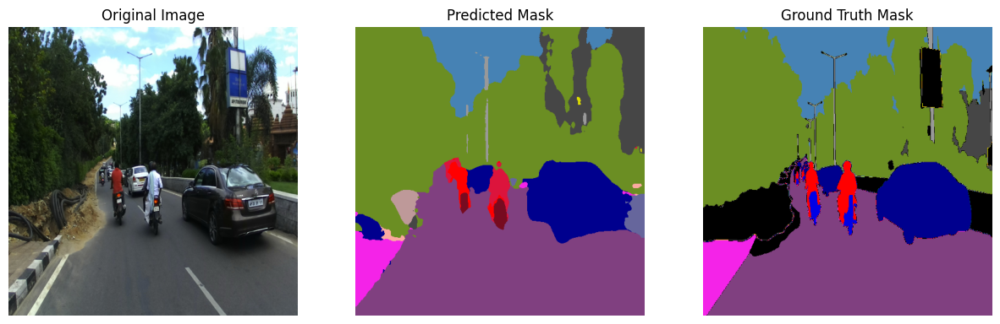

Visualizing for class: 3 - Unknown
Visualizing for class: 4 - Person


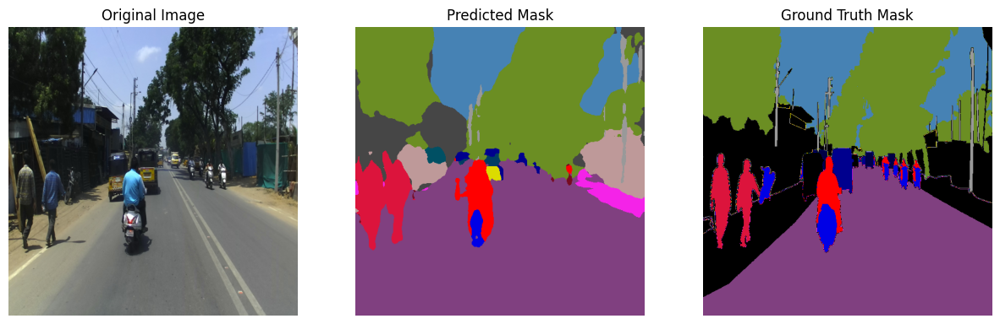

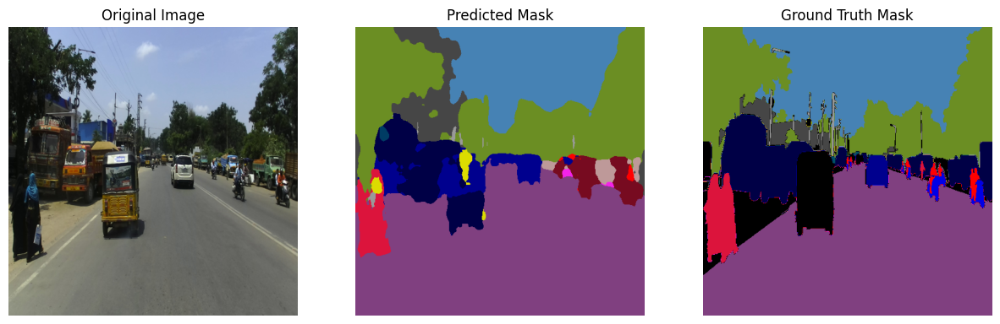

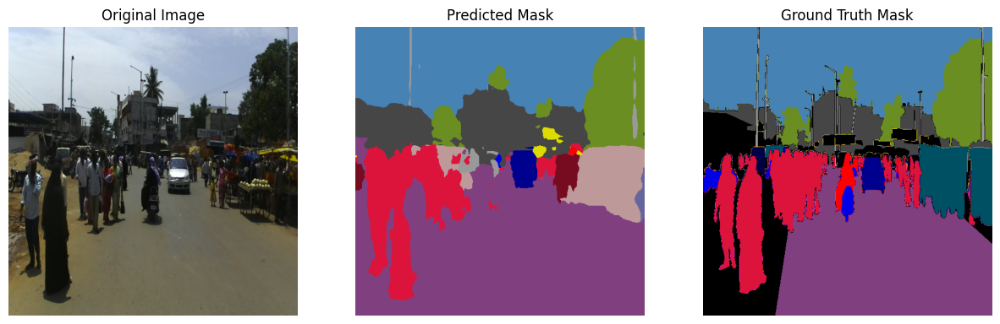

Visualizing for class: 5 - Rider


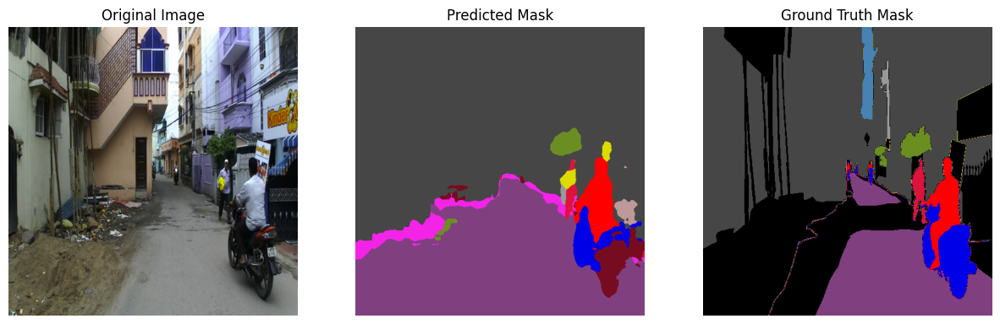

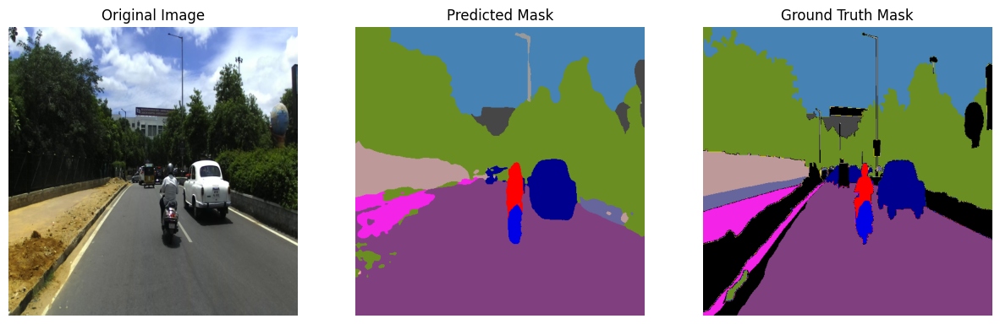

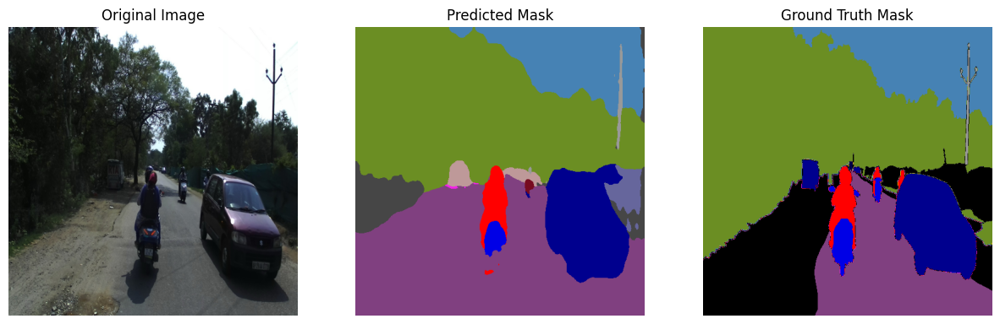

Visualizing for class: 6 - Motorbike


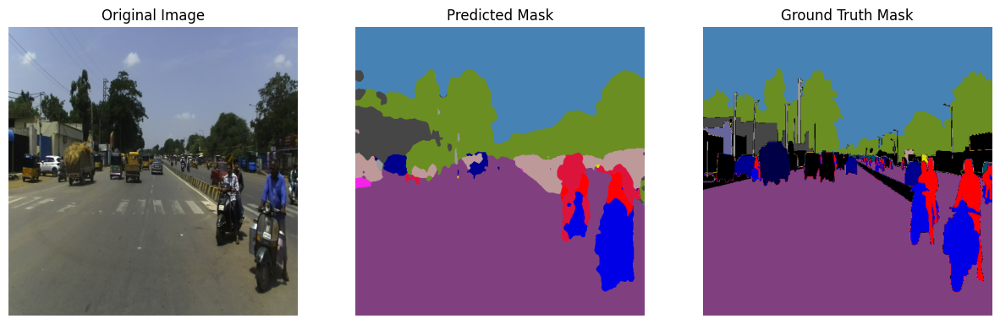

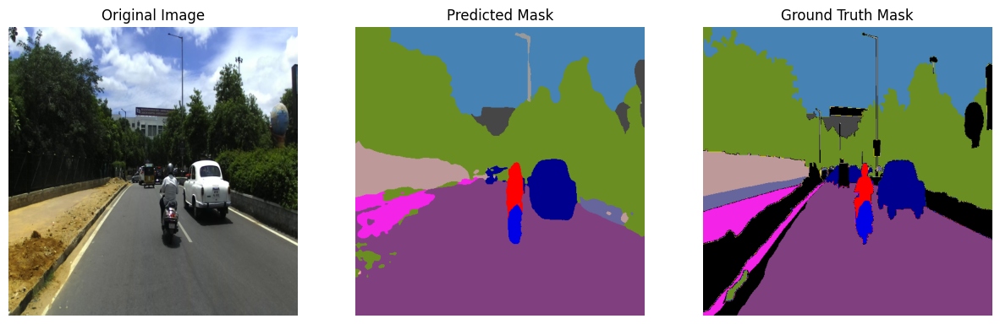

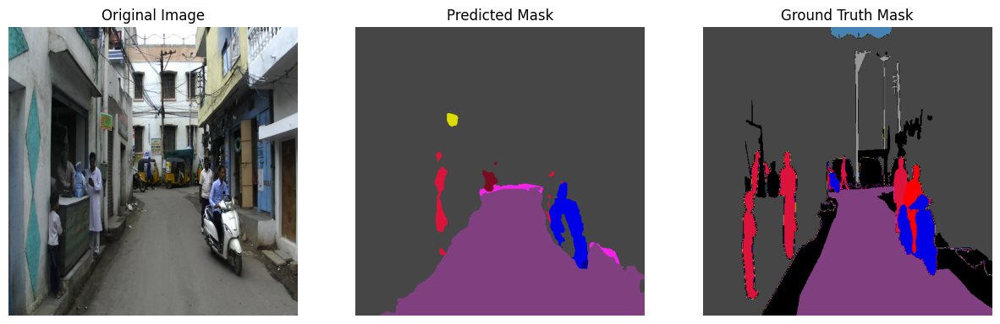

Visualizing for class: 7 - Bicycle


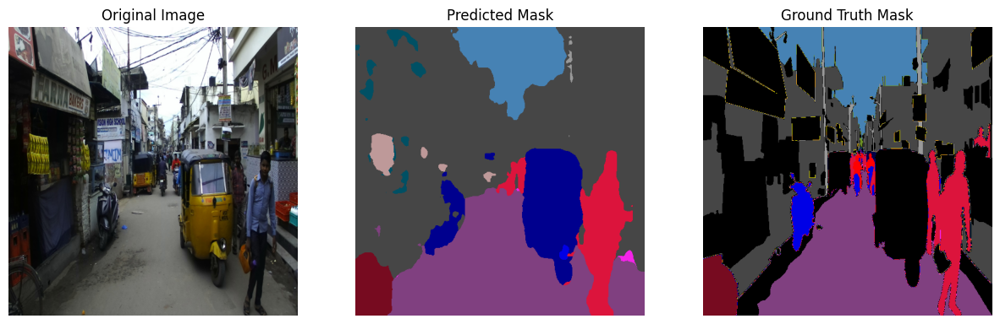

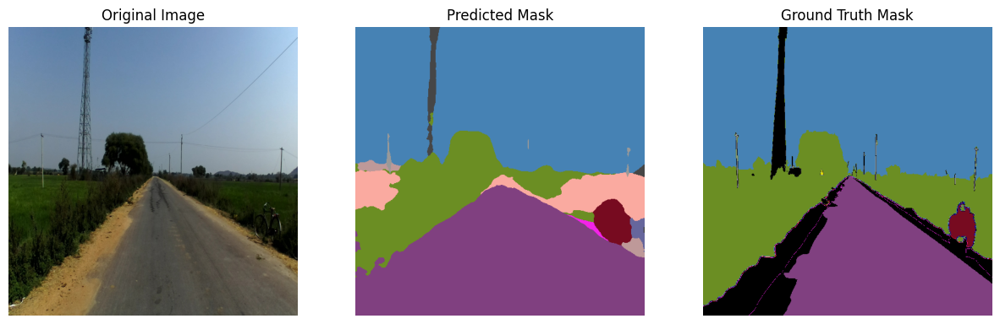

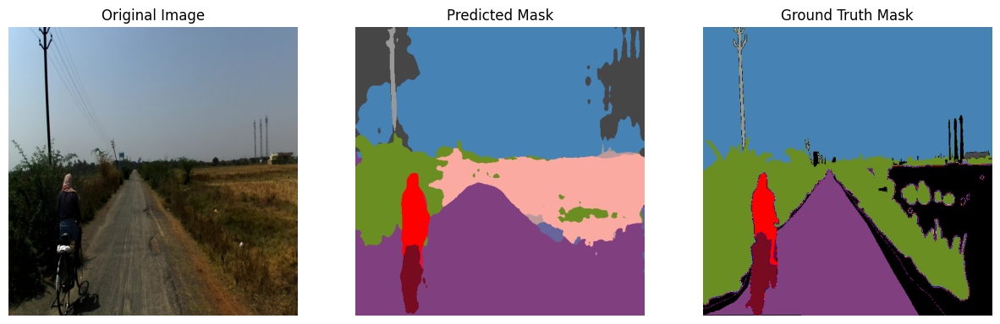

Visualizing for class: 8 - Unknown
Visualizing for class: 9 - Car


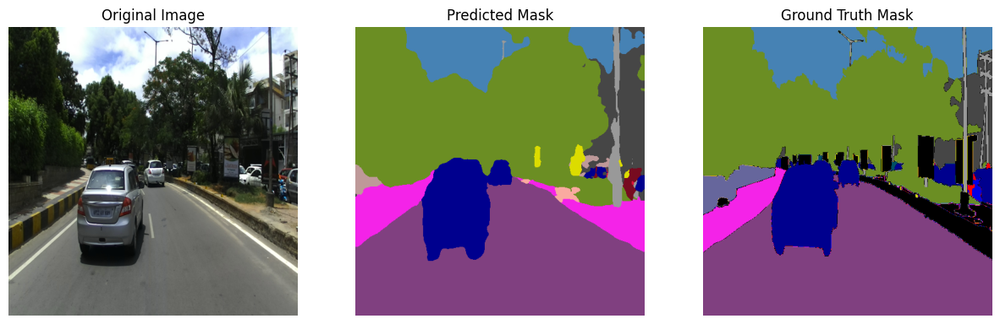

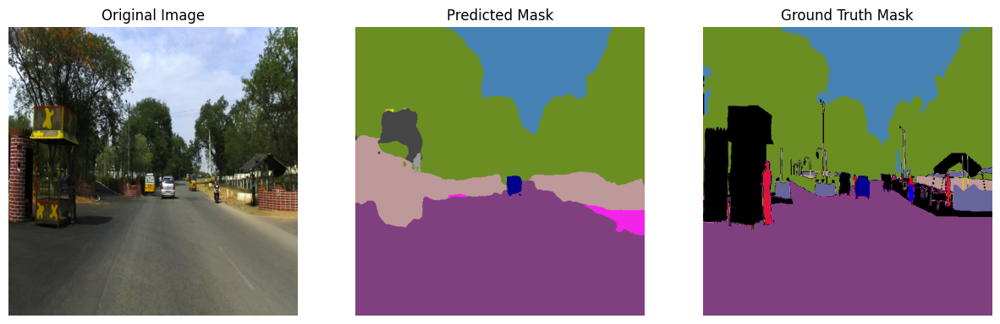

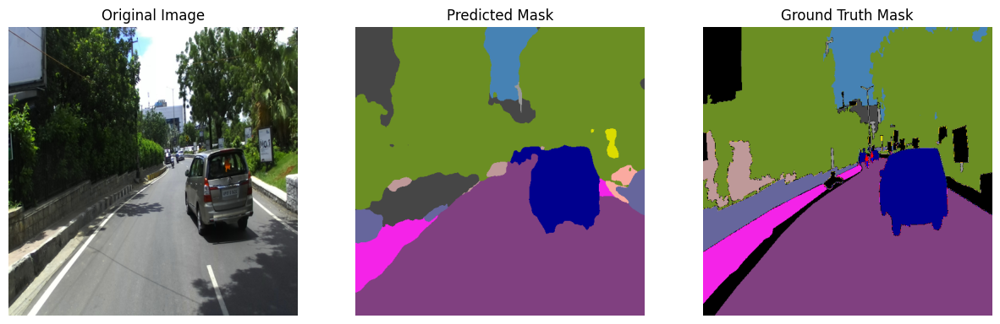

Visualizing for class: 10 - Truck


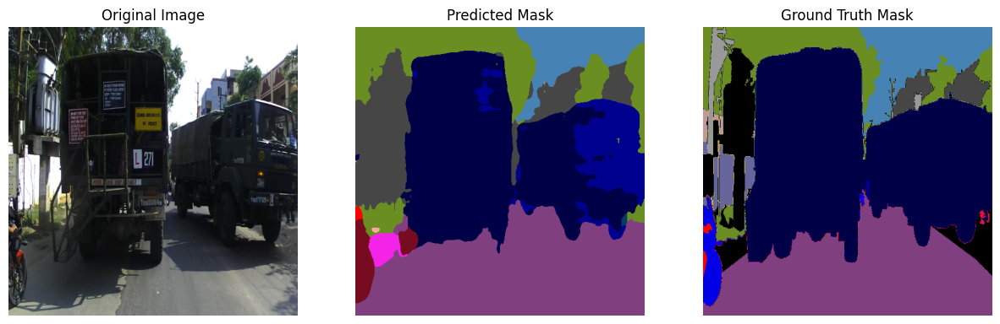

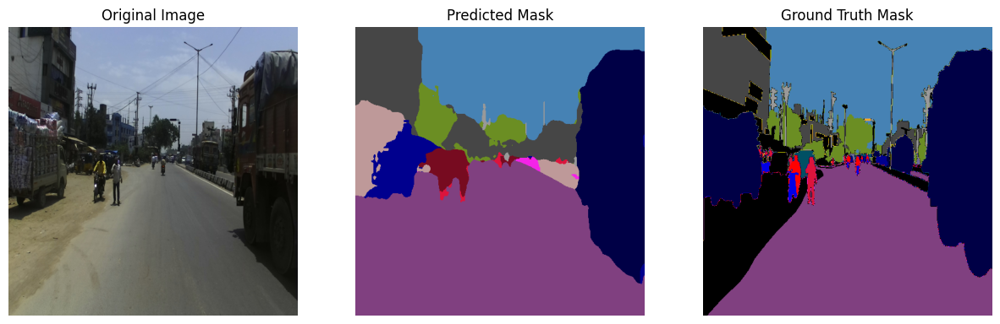

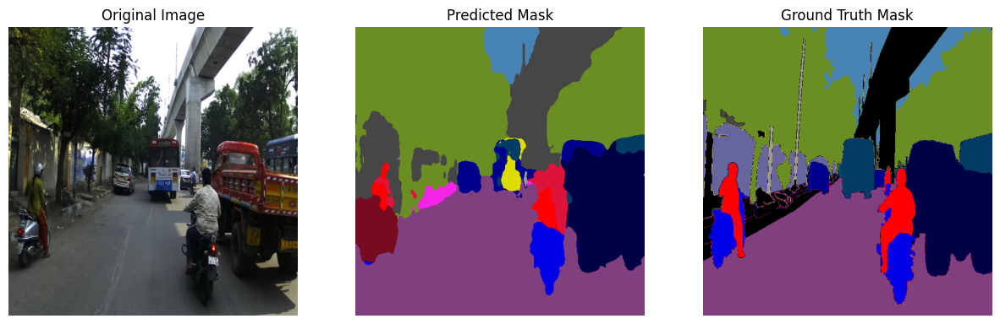

Visualizing for class: 11 - Bus


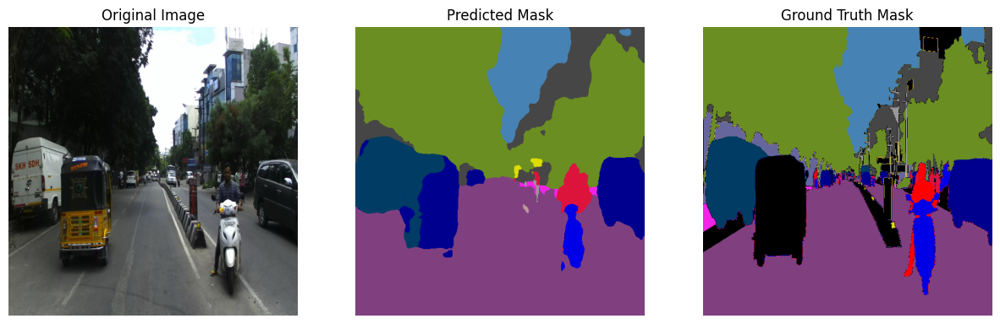

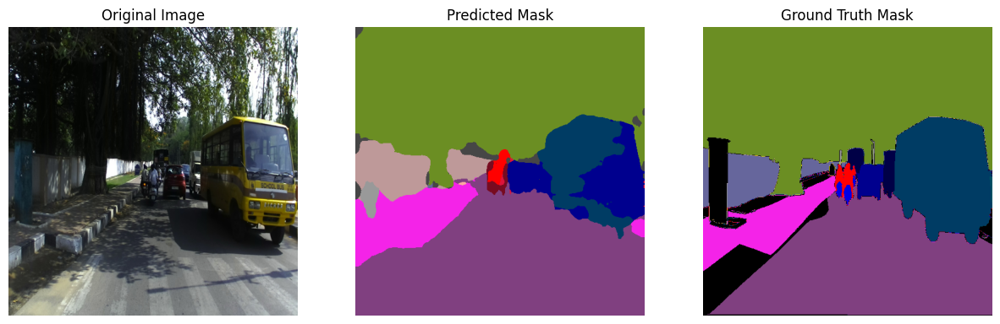

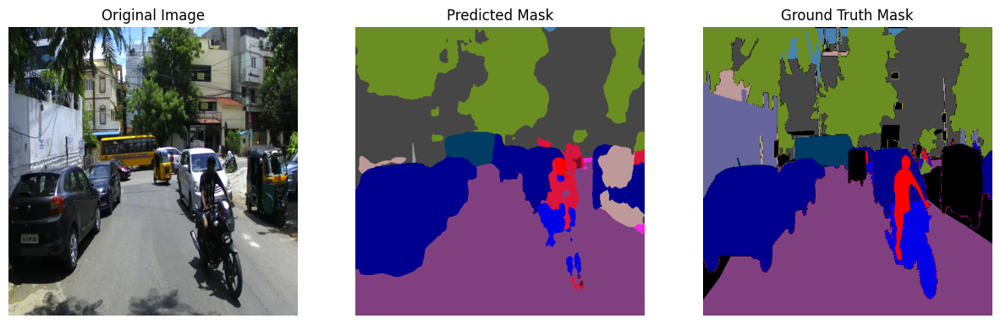

Visualizing for class: 12 - Train
Visualizing for class: 13 - Unknown
Visualizing for class: 14 - Wall


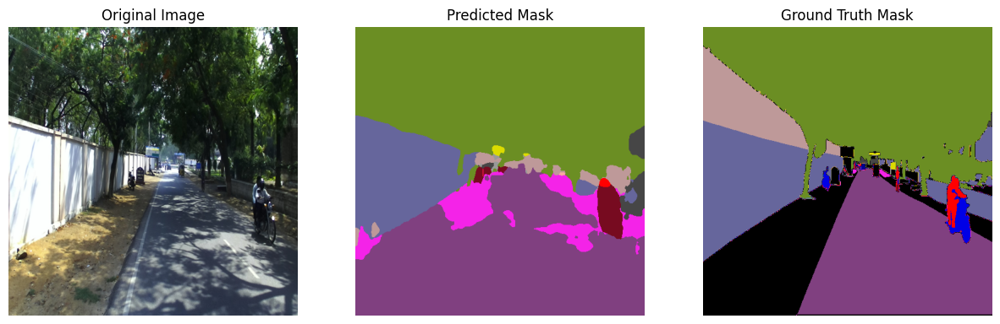

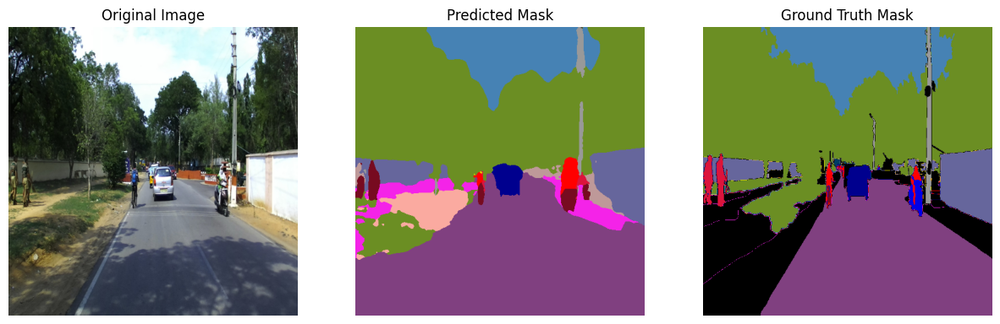

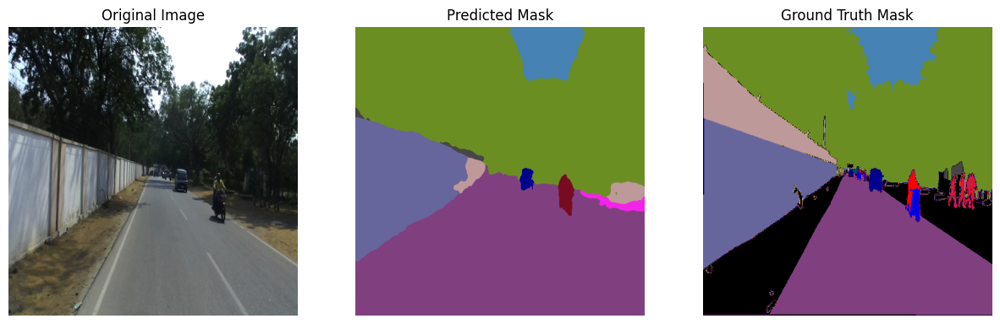

Visualizing for class: 15 - Fence


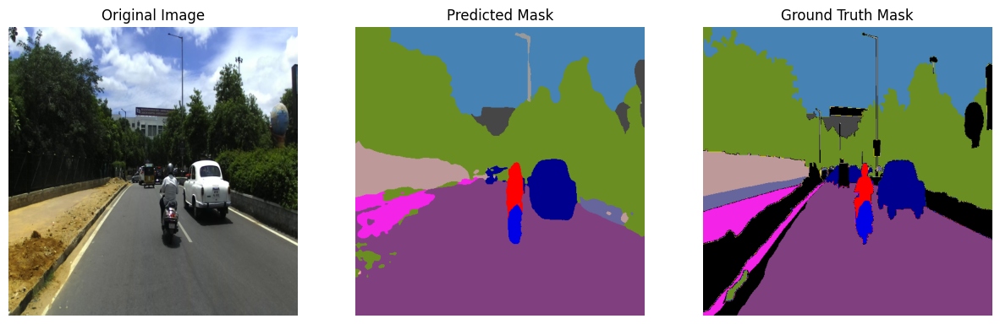

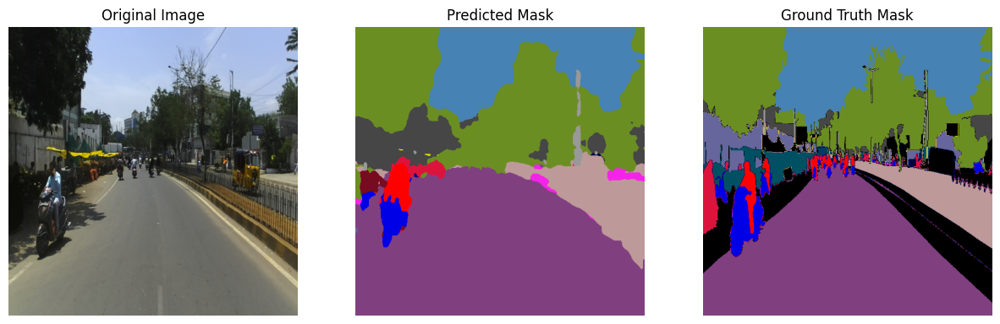

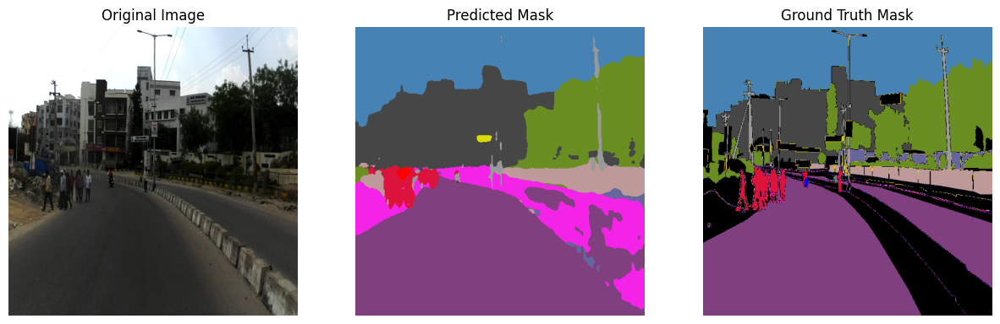

Visualizing for class: 16 - Unknown
Visualizing for class: 17 - Unknown


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def map_predictions(preds, cityscapes_to_idd):
    mapped_preds = np.vectorize(cityscapes_to_idd.get)(preds, 255)
    return mapped_preds


def decode_segmentation_masks(mask, label_color_mapping):
    color_mask = np.zeros((mask.shape[0], mask.shape[1], 3), dtype=np.uint8)
    for label, color in label_color_mapping.items():
        color_mask[mask == label] = color
    return color_mask

def calculate_iou(pred_mask, gt_mask, class_id, cityscapes_to_idd):
    mapped_pred_mask = map_predictions(pred_mask, cityscapes_to_idd)

    intersection = np.logical_and(mapped_pred_mask == class_id, gt_mask == class_id).sum()
    union = np.logical_or(mapped_pred_mask == class_id, gt_mask == class_id).sum()
    if union == 0:
        return 0
    else:
        return intersection / union


num_classes = len(class_labels)
iou_threshold = 0.5
selected_images_per_class = {class_id: [] for class_id in range(num_classes)}

for img_index in range(len(test_images)):
    for class_id in range(num_classes):
        pred_mask = all_preds_array[img_index]
        gt_mask = all_gts_array[img_index]

        iou = calculate_iou(pred_mask, gt_mask, class_id, cityscapes_to_idd)

        if iou <= iou_threshold:
            selected_images_per_class[class_id].append(img_index)


for class_id in range(num_classes):
    print(f"Visualizing for class: {class_id} - {class_labels.get(class_id, 'Unknown')}")
    selected_images = selected_images_per_class[class_id][:3]

    for img_index in selected_images:
        img_path = test_images[img_index]
        img = Image.open(img_path).resize((512, 512))

        pred_mask = all_preds_array[img_index]
        color_pred_mask = decode_segmentation_masks(pred_mask, cityscape_id_to_color)

        gt_mask = all_gts_array[img_index]
        color_gt_mask = decode_segmentation_masks(gt_mask, label_color_mapping)

        # Visualization
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title('Original Image')
        plt.subplot(1, 3, 2)
        plt.imshow(color_pred_mask)
        plt.axis('off')
        plt.title('Predicted Mask')
        plt.subplot(1, 3, 3)
        plt.imshow(color_gt_mask)
        plt.axis('off')
        plt.title('Ground Truth Mask')
        plt.show()


In [ ]:
pip install matplotlib seaborn

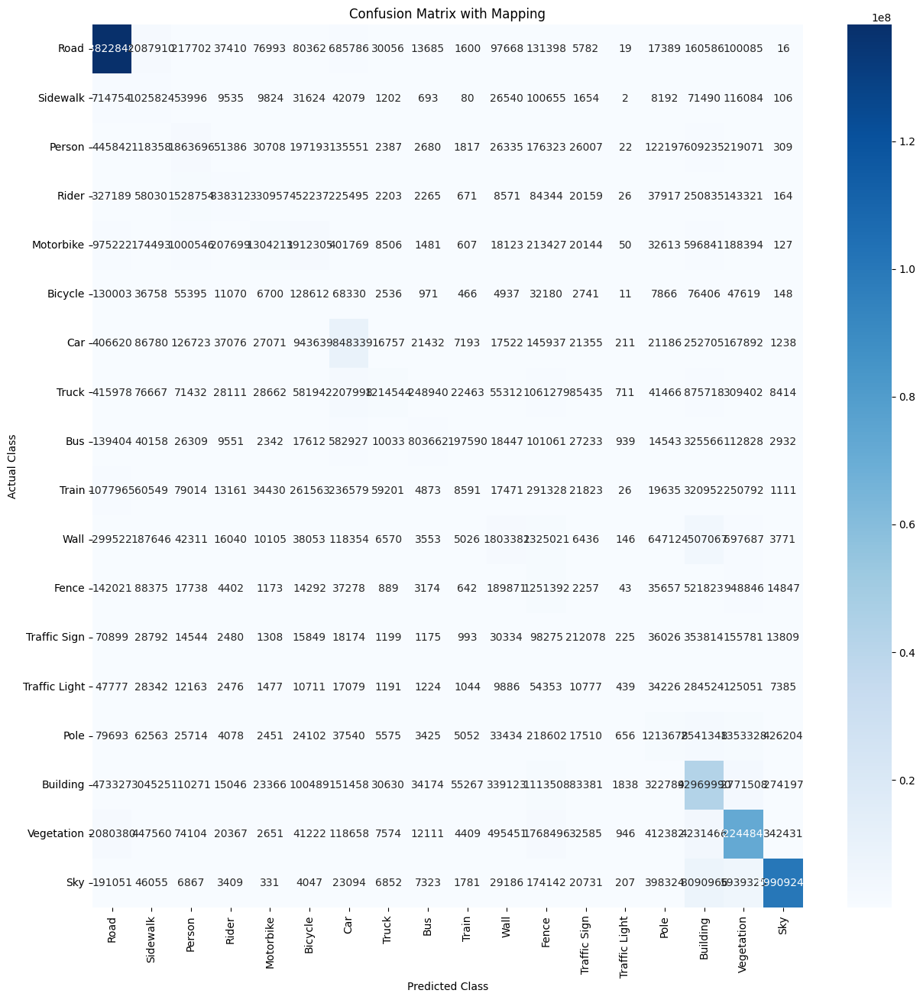

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

def map_predictions(preds, mapping):
    mapped_preds = np.vectorize(mapping.get)(preds, 255)
    return mapped_preds

mapped_preds_flat = np.concatenate([map_predictions(pred.flatten(), cityscapes_to_idd) for pred in all_preds_array])
gts_flat = np.concatenate([gt.flatten() for gt in all_gts_array])
unique_labels = sorted(class_labels.keys())

cm = confusion_matrix(gts_flat, mapped_preds_flat, labels=unique_labels)

plt.figure(figsize=(15, 15))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=[class_labels[label] for label in unique_labels], yticklabels=[class_labels[label] for label in unique_labels])
plt.title('Confusion Matrix with Mapping')
plt.ylabel('Actual Class')
plt.xlabel('Predicted Class')
plt.show()

In [ ]:
from sklearn.metrics import precision_recall_fscore_support
import numpy as np

precision, recall, f1, _ = precision_recall_fscore_support(gts_flat, mapped_preds_flat, labels=unique_labels)


for i, class_id in enumerate(unique_labels):
    class_label = class_labels.get(class_id, "Unknown")
    print(f"Class: {class_label}")
    print(f"  Precision: {precision[i]}")
    print(f"  Recall: {recall[i]}")
    print(f"  F1 Score: {f1[i]}\n")

Class: Road
  Precision: 0.7415688352961356
  Recall: 0.9733343535981208
  F1 Score: 0.8417902860357704

Class: Sidewalk
  Precision: 0.0860101745861727
  Recall: 0.45539635158723535
  F1 Score: 0.14469245497561212

Class: Person
  Precision: 0.2971849254189731
  Recall: 0.460575224770929
  F1 Score: 0.361264745286679

Class: Rider
  Precision: 0.5790051310599379
  Recall: 0.19390706148845305
  F1 Score: 0.29051989251299054

Class: Motorbike
  Precision: 0.5828244134946504
  Recall: 0.1845462650837334
  F1 Score: 0.28032884683401044

Class: Bicycle
  Precision: 0.030589880070792552
  Recall: 0.20705399000566688
  F1 Score: 0.05330460844973287

Class: Car
  Precision: 0.47893001730128626
  Recall: 0.8702860648826829
  F1 Score: 0.6178493209725898

Class: Truck
  Precision: 0.6211128794046533
  Recall: 0.17782629613762685
  F1 Score: 0.2764921441058085

Class: Bus
  Precision: 0.6007641285667619
  Recall: 0.32893948938089573
  F1 Score: 0.42511407264467627

Class: Train
  Precision: 0.01